<h1>Parkinson's Detection</h1>

# About the Data

**Title:** Parkinsons Disease Data Set

**Source:**

'Exploiting Nonlinear Recurrence and Fractal Scaling Properties for Voice Disorder Detection', 
Little MA, McSharry PE, Roberts SJ, Costello DAE, Moroz IM. 
BioMedical Engineering OnLine 2007, 6:23 (26 June 2007)

https://archive.ics.uci.edu/ml/datasets/parkinsons

**Details:**

>**Data Set Information:**
>
>This dataset is composed of 22 different biomedical voice measurements from 32 people: 24 with Parkinson's disease (PD) and 8 healthy controls. Each column in the table is a particular voice measure, and each row corresponds one of 195 voice recording from these individuals ("name" column). The main aim of the data is to discriminate healthy people from those with PD, according to "status" column which is set to 0 for healthy and 1 for PD.
>
>The data is in ASCII CSV format. The rows of the CSV file contain an instance corresponding to one voice recording. There are around six recordings per patient, the name of the patient is identified in the first column.
>
>**Attribute Information:**
>- name - ASCII subject name and recording number
>- status - Health status of the subject: 1 - Parkinson's, 0 - healthy
>- MDVP:Fo (Hz) - Average vocal fundamental frequency
>- MDVP:Fhi (Hz) - Maximum vocal fundamental frequency
>- MDVP:Flo (Hz) - Minimum vocal fundamental frequency
>- MDVP:Jitter (%), MDVP:Jitter (Abs), MDVP:RAP, MDVP:PPQ, Jitter:DDP - Several measures of variation in fundamental frequency
>- MDVP:Shimmer, MDVP:Shimmer (dB), Shimmer:APQ3, Shimmer:APQ5, MDVP:APQ, Shimmer:DDA - Several measures of variation in amplitude
>- NHR, HNR - Two measures of ratio of noise to tonal components in the voice
>- RPDE, D2 - Two nonlinear dynamical complexity measures
>- DFA - Signal fractal scaling exponent
>- spread1, spread2, PPE - Three nonlinear measures of fundamental frequency variation 


# Imports

In [14]:
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier, IsolationForest
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, f1_score, balanced_accuracy_score
from sklearn.model_selection import KFold, train_test_split
from imblearn.over_sampling import SMOTE, RandomOverSampler
from tensorboard.plugins.hparams import api as hp
from keras.models import Sequential
from keras.layers import Layer, Activation, Dropout, Dense
from keras.initializers import RandomUniform, Initializer, Constant

!pip install --no-dependencies git+https://github.com/albertbup/deep-belief-network.git
from dbn import SupervisedDBNClassification

%reload_ext tensorboard

sns.set(font_scale = 1.5)
RANDOM_STATE = 42

class color:
   PURPLE = '\033[95m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/albertbup/deep-belief-network.git to /tmp/pip-req-build-ow_turhu
  Running command git clone -q https://github.com/albertbup/deep-belief-network.git /tmp/pip-req-build-ow_turhu


# Data Preparation

## Download and Verify Dataset

In [2]:
!wget -O /content/parkinsons.data https://archive.ics.uci.edu/ml/machine-learning-databases/parkinsons/parkinsons.data

df = pd.read_csv('/content/parkinsons.data')
df[['name','name_index']] = pd.DataFrame(df.name.str.rsplit('_', 1).tolist(), df.index)

df_class = df['status']
df_data = df.drop(['status','name','name_index'], axis = 1)
df_subjects = df.drop_duplicates('name', ignore_index=True)[['name','status']]

df.info()

--2022-06-19 05:11:11--  https://archive.ics.uci.edu/ml/machine-learning-databases/parkinsons/parkinsons.data
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 40697 (40K) [application/x-httpd-php]
Saving to: ‘/content/parkinsons.data’

/content/parkinsons 100%[===================>]  39.74K  --.-KB/s    in 0.07s   

2022-06-19 05:11:11 (588 KB/s) - ‘/content/parkinsons.data’ saved [40697/40697]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5

# Visualization

In [3]:
def plot_data_dist(class_column, title, ylabel = 'Count of Samples'):
  plt.figure()
  sns.countplot(x=class_column)
  plt.title(title)
  plt.ylabel(ylabel)
  plt.xlabel('')
  plt.xticks(ticks=[0,1],labels=['Healthy','Parkinsons Disease'])
  plt.show()

### Subject and Sample Distribution

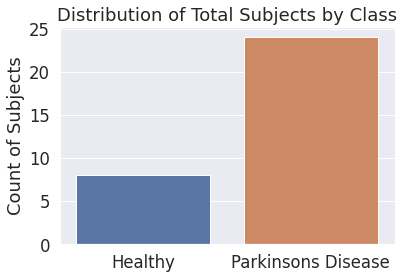

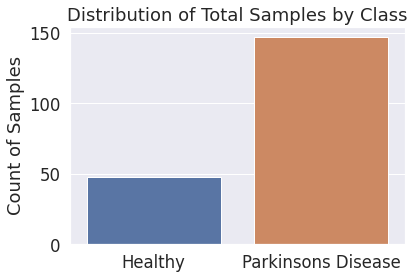

In [4]:
plot_data_dist(df_subjects['status'],'Distribution of Total Subjects by Class','Count of Subjects')
print()
plot_data_dist(df['status'], 'Distribution of Total Samples by Class','Count of Samples')

In [5]:
print('Total Number of Subjects: ', df_subjects.shape[0])
print('Number of Subjects with PD: ', df_subjects.loc[df_subjects['status'] == 1].shape[0])
print('Number of Control Subjects: ', df_subjects.loc[df_subjects['status'] == 0].shape[0])
print()
print('Total Number of Samples: ', df.shape[0])
print('Number of Samples with PD: ', df.loc[df['status'] == 1].shape[0])
print('Number of Control Samples: ', df.loc[df['status'] == 0].shape[0])

Total Number of Subjects:  32
Number of Subjects with PD:  24
Number of Control Subjects:  8

Total Number of Samples:  195
Number of Samples with PD:  147
Number of Control Samples:  48


### Samples per Subject

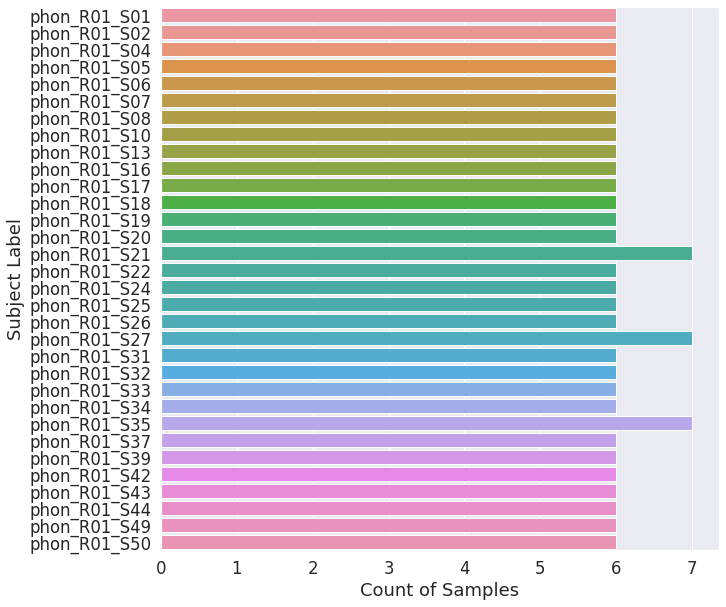

In [6]:
plt.figure(figsize=(10,10))
sns.countplot(y=df['name'])
plt.ylabel('Subject Label')
plt.xlabel('Count of Samples')
plt.show()

### Violin Plot

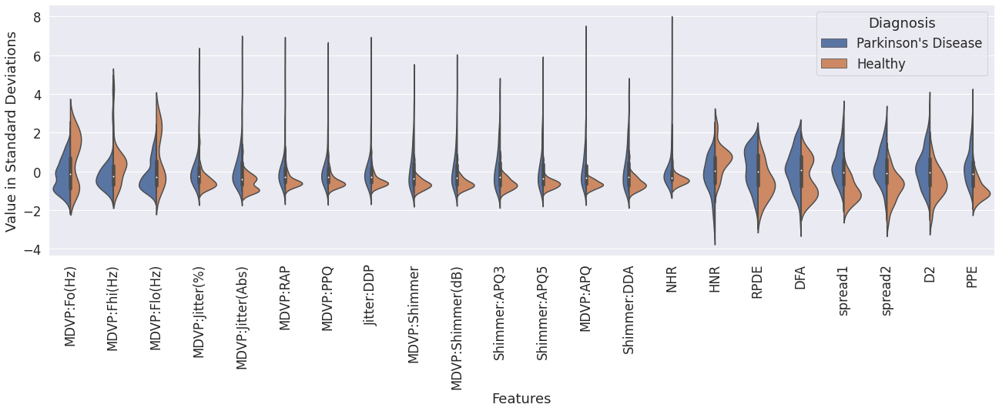

In [7]:
mean = np.mean(df_data, axis = 0)
std = np.std(df_data, axis = 0)
df_temp = (df_data - mean) / std
df_temp['Diagnosis'] = np.where(df_class==1,'Parkinson\'s Disease', 'Healthy')
df_temp = pd.melt(df_temp,id_vars="Diagnosis", var_name="features", value_name='value')
plt.figure(figsize=(22,6))
_ = sns.violinplot(data = df_temp, x = 'features', y = 'value', hue = 'Diagnosis', split = True, hue_order = ['Parkinson\'s Disease', 'Healthy'])
plt.ylabel(ylabel = 'Value in Standard Deviations')
plt.xlabel(xlabel = 'Features')
_ = plt.xticks(rotation=90)

### Pairplot

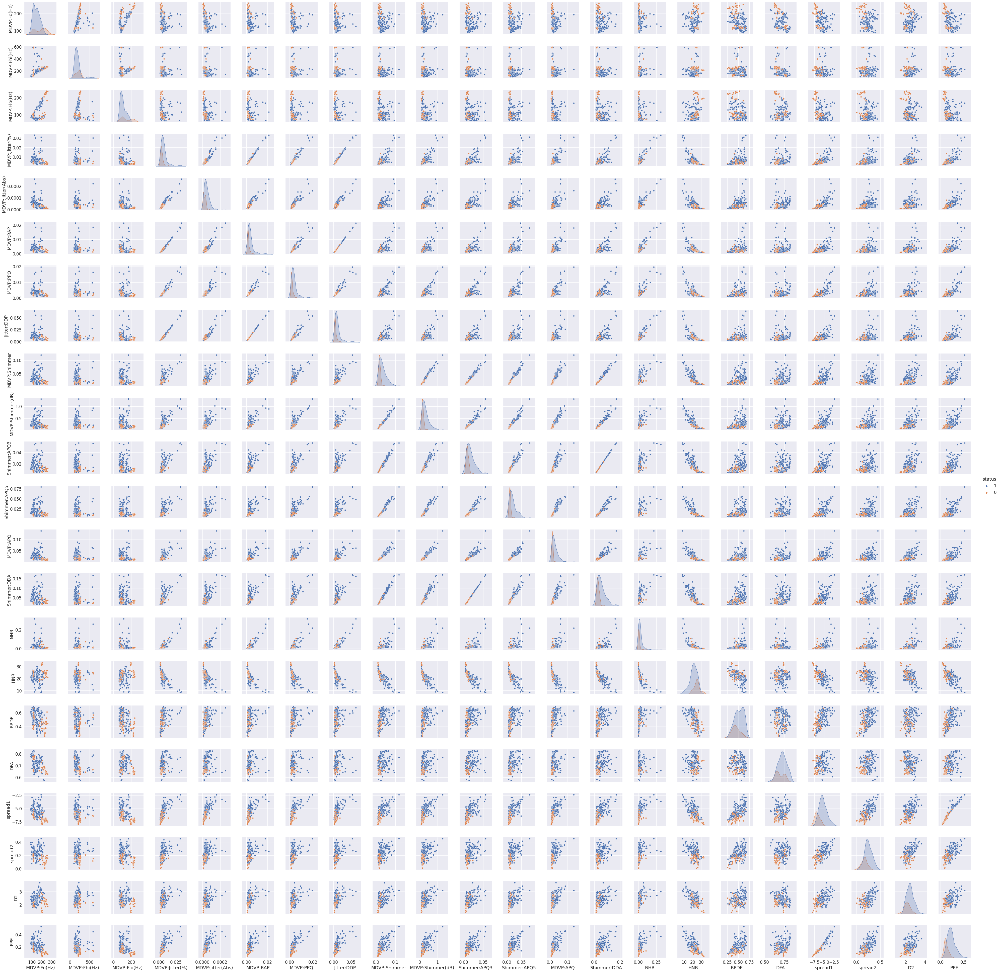

In [ ]:
sns.pairplot(data = df.drop(['name','name_index'], axis=1), hue = 'status', hue_order = [1,0])
plt.show()

# Outlier Detection and Removal

This code identifies up to 5% of samples as outliers using IsolationForest approach from SKLearn. It identified subjects 24 and 35 as having the majority of the outlier samples. Removing these outliers does reduce the spread in the violin plot. However, further testing revealed that removing these samples actually decreased the accuracy of the models, so the outlier removal has been disabled. This is likely becuase the dataset is so small. The code has been left to illustrate what it would look like if outliers were removed.

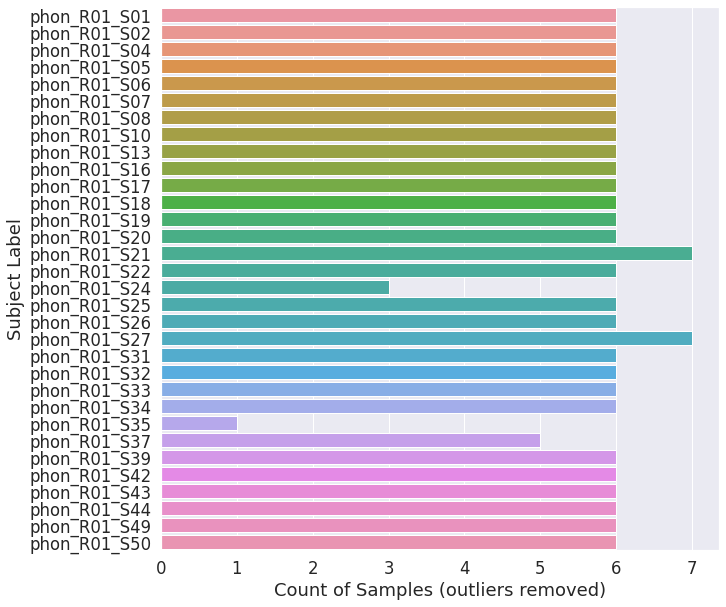

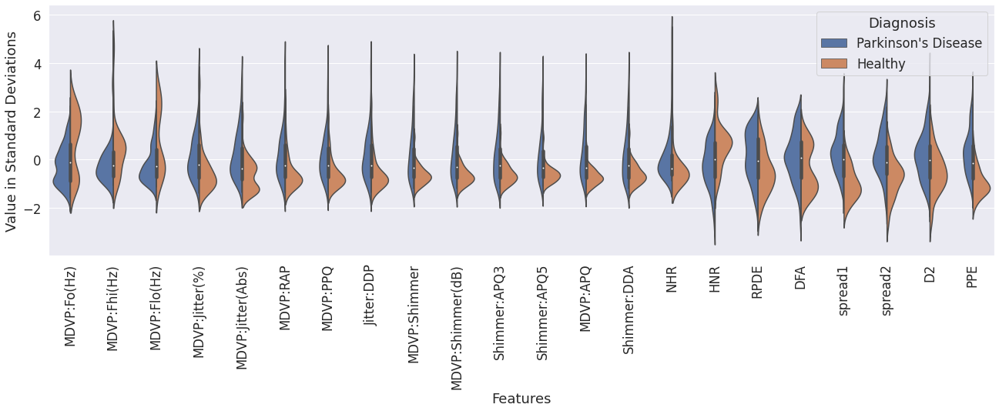

In [10]:
iso = IsolationForest(n_estimators = 200, contamination=0.05)
mask = iso.fit_predict(np.array(df_data))
df_cleaned = df.loc[mask == 1]
df_cleaned.reset_index(drop=True, inplace=True)
df_class_cleaned = df_cleaned['status']
df_data_cleaned = df_cleaned.drop(['status','name','name_index'], axis = 1)

plt.figure(figsize=(10,10))
sns.countplot(y=df_cleaned['name'])
plt.ylabel('Subject Label')
plt.xlabel('Count of Samples (outliers removed)')
plt.show()
print()

mean = np.mean(df_data_cleaned, axis = 0)
std = np.std(df_data_cleaned, axis = 0)
df_temp = (df_data_cleaned - mean) / std
df_temp['Diagnosis'] = np.where(df_class_cleaned==1,'Parkinson\'s Disease', 'Healthy')
df_temp = pd.melt(df_temp,id_vars="Diagnosis", var_name="features", value_name='value')
plt.figure(figsize=(22,6))
_ = sns.violinplot(data = df_temp, x = 'features', y = 'value', hue = 'Diagnosis', split = True, hue_order = ['Parkinson\'s Disease', 'Healthy'])
plt.ylabel(ylabel = 'Value in Standard Deviations')
plt.xlabel(xlabel = 'Features')
_ = plt.xticks(rotation=90)

# The code below removes the outliers if uncommented
#df_subjects = df_subjects[(df_subjects['name']!='phon_R01_S24') & (df_subjects['name']!='phon_R01_S35')] #Remove subjects 24 and 35 for excessive outliers

# Data Preprocessing

## Training and Testing Splits

Dividing the subjects (not just the samples) into train, validation and testing sets. This will ensure that the model will not be trained on any samples from the subjects used for testing. This will ensure a more realistic test of the model performance. 

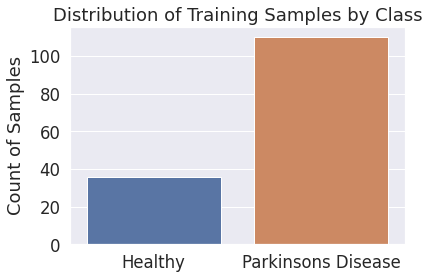

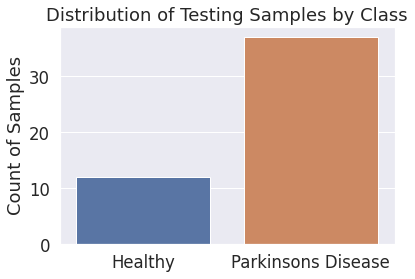

In [8]:
train_subjects, test_subjects = train_test_split(df_subjects['name'], test_size=0.25, shuffle=True, random_state=RANDOM_STATE, stratify=df_subjects['status'])
train_subjects.reset_index(drop=True, inplace=True)
test_subjects.reset_index(drop=True, inplace=True)

training_data_unnormalized = df_data.loc[df['name'].isin(train_subjects)]
training_class = df_class.loc[df['name'].isin(train_subjects)]
testing_data_unnormalized = df_data.loc[df['name'].isin(test_subjects)]
testing_class = df_class.loc[df['name'].isin(test_subjects)]

# The code below creates train-test split directly with the samples, without accounting for the subjects. Uncomment to test the models with this split approach
# Testing reavealed that this split approach does not improve performance, and since it is also not realistic, it has been disabled
#training_data_unnormalized, testing_data_unnormalized, training_class, testing_class = train_test_split(df_data, df_class, test_size=0.25, shuffle=True, random_state=RANDOM_STATE, stratify=df_class)
#training_data_unnormalized.reset_index(drop=True, inplace=True)
#testing_data_unnormalized.reset_index(drop=True, inplace=True)

x_mean = np.mean(training_data_unnormalized, axis = 0) # Normalize it in the column direction
x_std = np.std(training_data_unnormalized, axis = 0)
training_data = (training_data_unnormalized - x_mean) / x_std
testing_data = (testing_data_unnormalized - x_mean) / x_std

plot_data_dist(training_class, 'Distribution of Training Samples by Class')
print()
plot_data_dist(testing_class, 'Distribution of Testing Samples by Class')

## Handling Class Imbalance

### SMOTE

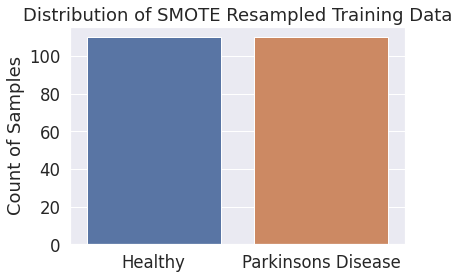

In [9]:
sm = SMOTE(random_state=RANDOM_STATE)
training_data_smote, training_class_smote = sm.fit_resample(training_data, training_class)
plot_data_dist(training_class_smote, 'Distribution of SMOTE Resampled Training Data')

### Traditional Random Oversampling


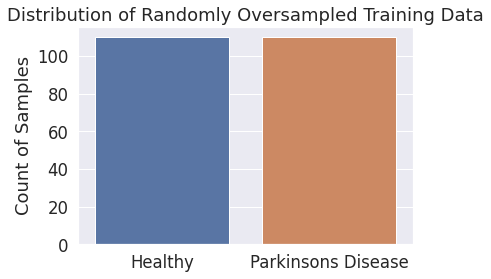

In [10]:
ros = RandomOverSampler(random_state=RANDOM_STATE)
training_data_ros, training_class_ros = sm.fit_resample(training_data, training_class)
plot_data_dist(training_class_ros, 'Distribution of Randomly Oversampled Training Data')

### List of Datasets

In [11]:
datasets = [[training_data, training_class, 'Baseline'],
            [training_data_smote, training_class_smote, 'SMOTE'],
            [training_data_ros, training_class_ros, 'Random Oversampling']]

# Conventional Machine Learning Models

## Model Definition

In [12]:
class TestModel:
  def __init__(self, name, model, param_grid): #Constructor
    self.name = name
    self.param_grid = param_grid
    self.model = model
    self.grid_search = GridSearchCV(self.model, self.param_grid, refit = True, n_jobs=-1) 

  def train_model(self, train_data, train_class):
    self.grid_search.fit(train_data, train_class) 
    return self.grid_search.best_params_

  def prediction_report(self, testing_data, testing_class):
    start_time = time.time()
    grid_predictions = self.grid_search.predict(testing_data)
    stop_time = time.time()
    report = classification_report(testing_class, grid_predictions, labels = [0,1], target_names = ['Healthy','Parkinsons Disease'])
    f1 = f1_score(testing_class, grid_predictions, average='weighted')
    b_acc = balanced_accuracy_score(testing_class, grid_predictions)
    return  f1, b_acc, report, (stop_time - start_time), confusion_matrix(testing_class, grid_predictions)

models = [TestModel(
              'Support Vector Machine',
              SVC(),
              { 'C': [0.1, 1, 10],  
                'gamma': ['scale','auto'], 
                'kernel': ['linear', 'rbf']} 
                ),
          TestModel(
              'K Nearest Neighbor',
              KNeighborsClassifier(),
              { 'n_neighbors': [5, 10, 25, 50],  
                'weights': ['uniform', 'distance'],
                'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']} 
                ), 
          TestModel(
              'Gaussian Naive Bayes',
              GaussianNB(),
              {}
          ),
          TestModel(
              'Linear Discriminant Analysis',
              LinearDiscriminantAnalysis(),
              {}
          ),          
          TestModel(
              'Adaboost',
              AdaBoostClassifier(),
              {"n_estimators": np.arange(50, 150, 10)}
          )]

## Sample Model Performance

Model: Support Vector Machine

Best hyperparameters: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Test time: 0.0018544197082519531 ms
Classification Report:
                    precision    recall  f1-score   support

           Healthy       1.00      0.25      0.40        12
Parkinsons Disease       0.80      1.00      0.89        37

          accuracy                           0.82        49
         macro avg       0.90      0.62      0.65        49
      weighted avg       0.85      0.82      0.77        49

Confusion Matrix:



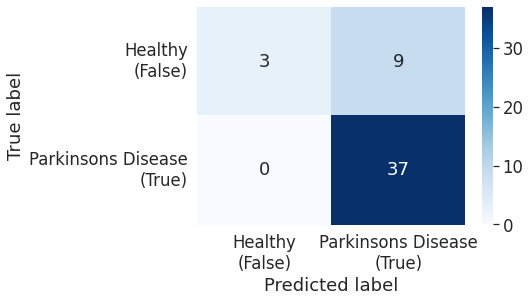




Model: K Nearest Neighbor

Best hyperparameters: {'algorithm': 'auto', 'n_neighbors': 5, 'weights': 'uniform'}
Test time: 0.007154703140258789 ms
Classification Report:
                    precision    recall  f1-score   support

           Healthy       1.00      0.42      0.59        12
Parkinsons Disease       0.84      1.00      0.91        37

          accuracy                           0.86        49
         macro avg       0.92      0.71      0.75        49
      weighted avg       0.88      0.86      0.83        49

Confusion Matrix:



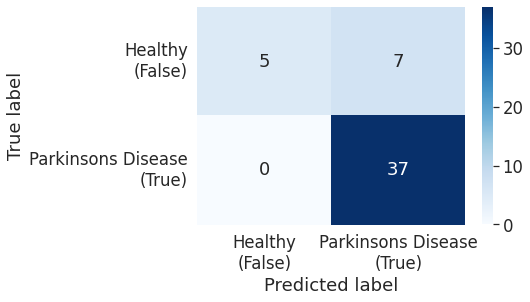




Model: Gaussian Naive Bayes

Best hyperparameters: N/A
Test time: 0.0015869140625 ms
Classification Report:
                    precision    recall  f1-score   support

           Healthy       1.00      0.92      0.96        12
Parkinsons Disease       0.97      1.00      0.99        37

          accuracy                           0.98        49
         macro avg       0.99      0.96      0.97        49
      weighted avg       0.98      0.98      0.98        49

Confusion Matrix:



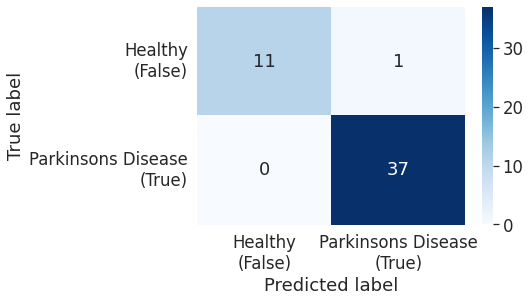




Model: Linear Discriminant Analysis

Best hyperparameters: N/A
Test time: 0.0015654563903808594 ms
Classification Report:
                    precision    recall  f1-score   support

           Healthy       0.40      0.50      0.44        12
Parkinsons Disease       0.82      0.76      0.79        37

          accuracy                           0.69        49
         macro avg       0.61      0.63      0.62        49
      weighted avg       0.72      0.69      0.70        49

Confusion Matrix:



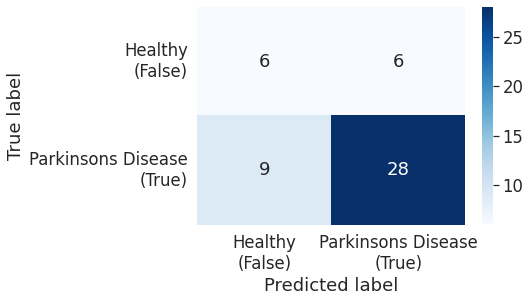




Model: Adaboost

Best hyperparameters: {'n_estimators': 120}
Test time: 0.020525693893432617 ms
Classification Report:
                    precision    recall  f1-score   support

           Healthy       1.00      0.50      0.67        12
Parkinsons Disease       0.86      1.00      0.92        37

          accuracy                           0.88        49
         macro avg       0.93      0.75      0.80        49
      weighted avg       0.89      0.88      0.86        49

Confusion Matrix:



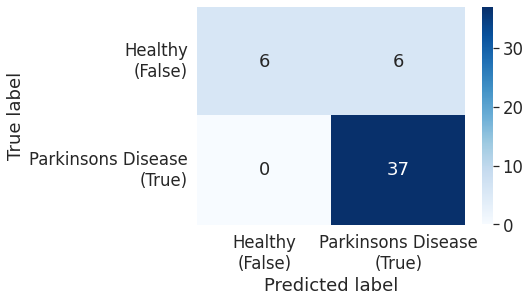

In [15]:
sns.set(font_scale = 1.5)
for m in models:
  print(f'{color.BOLD}Model:{color.END} {m.name}\n')
  best_params = m.train_model(training_data_smote, training_class_smote)
  print(f'{color.BOLD}Best hyperparameters:{color.END} {best_params if best_params != {} else "N/A"}')
  f1, b_acc, cr, tt, cm = m.prediction_report(testing_data, testing_class)
  print(f'{color.BOLD}Test time:{color.END} {tt} ms')
  print(f'{color.BOLD}Classification Report:{color.END}\n' + cr)
  print(f'{color.BOLD}Confusion Matrix:\n{color.END}')
  sns.heatmap(cm, annot=True, xticklabels=['Healthy\n(False)','Parkinsons Disease\n(True)'], yticklabels=['Healthy\n(False)','Parkinsons Disease\n(True)'], cmap='Blues')
  plt.ylabel('True label')
  plt.xlabel('Predicted label')
  plt.show()
  print('\n\n')

## Average Model Performance

In [ ]:
randomized_data_sets = []
results = []

for rand in range(1,100):
  train_subjects, test_subjects = train_test_split(df_subjects['name'], test_size=0.25, shuffle=True, random_state=rand, stratify=df_subjects['status'])
  train_subjects.reset_index(drop=True, inplace=True)
  test_subjects.reset_index(drop=True, inplace=True)
  training_data_unnormalized = df_data.loc[df['name'].isin(train_subjects)]
  training_class_temp = df_class.loc[df['name'].isin(train_subjects)]
  testing_data_unnormalized = df_data.loc[df['name'].isin(test_subjects)]
  testing_class_temp = df_class.loc[df['name'].isin(test_subjects)]

  x_mean = np.mean(training_data_unnormalized, axis = 0) # Normalize it in the column direction
  x_std = np.std(training_data_unnormalized, axis = 0)
  training_data_temp = (training_data_unnormalized - x_mean) / x_std
  testing_data_temp = (testing_data_unnormalized - x_mean) / x_std

  sm = SMOTE(random_state=RANDOM_STATE)
  training_data_smote_temp, training_class_smote_temp = sm.fit_resample(training_data_temp, training_class_temp)
  randomized_data_sets.append([training_data_smote_temp, training_class_smote_temp, testing_data_temp, testing_class_temp])

for ds in randomized_data_sets:
  for m in models:
    best_params = m.train_model(ds[0], ds[1])
    f1, b_acc, cr, tt, cm = m.prediction_report(ds[2], ds[3])
    results.append([m.name, best_params if best_params != {} else 'N/A', f1, b_acc, tt, cm])

results_df = pd.DataFrame(results, columns = ['Model Name', 'Best Parameters', 'F1 Score', 'Balanced Accuracy', 'Testing Time', 'Confusion Matrix'])

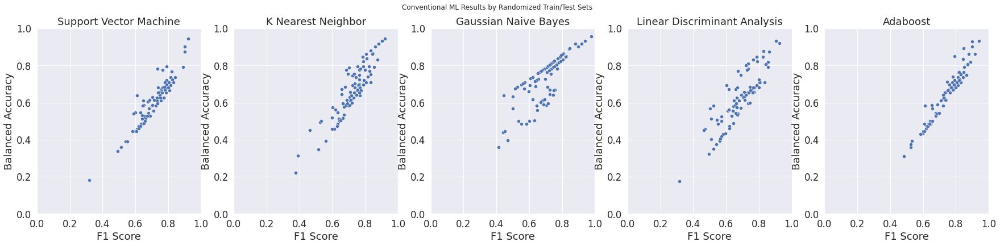

In [ ]:
plt.figure(figsize=(30,6))
i=1
for m in models:
  plt.subplot(1, 5, i)
  df_temp = results_df.loc[results_df['Model Name'] == m.name]
  sns.scatterplot(x = df_temp['F1 Score'], y= df_temp['Balanced Accuracy'])
  plt.ylabel('Balanced Accuracy')
  plt.xlabel('F1 Score')
  plt.xlim(0,1)
  plt.ylim(0,1)
  plt.title(m.name)
  i+=1
plt.suptitle('Conventional ML Results by Randomized Train/Test Sets')
plt.show()

In [ ]:
pd.pivot_table(results_df, index = results_df['Model Name'])

,Balanced Accuracy,F1 Score,Testing Time
Model Name,,,
Adaboost,0.643672,0.742301,0.023578
Gaussian Naive Bayes,0.724977,0.694330,0.001875
K Nearest Neighbor,0.666072,0.722462,0.003526
Linear Discriminant Analysis,0.627206,0.685933,0.001859
Support Vector Machine,0.612428,0.717323,0.002431


# Deep Learning Models

## Vanilla Feedforward Model

### Model Definition

In [16]:
def vff_create_model(units_1, units_2):
  model = tf.keras.models.Sequential([
  tf.keras.layers.Dense(units_1, input_dim=training_data.shape[1]),
  tf.keras.layers.Activation('relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(units_2),
  tf.keras.layers.Activation('relu'),
  tf.keras.layers.Dense(1),
  tf.keras.layers.Activation('sigmoid')])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
  return model

### Oversampling Method Selection

In [17]:
vff_models = []
for ds in datasets:
  local_model = vff_create_model(256, 256)
  local_model.fit(ds[0], ds[1], validation_split = 0.15, batch_size = 8, epochs = 25, verbose = 0)
  vff_models.append([local_model, ds[2]])

for m in vff_models:
  y_pred = m[0].predict(testing_data)>0.5
  print(f'\nWeighted F1 Score for {m[1]}: {f1_score(testing_class, y_pred, average="weighted"):.3f}')
  print(f'Balanced Accuracy Score for {m[1]}: {balanced_accuracy_score(testing_class, y_pred):.3f}')


Weighted F1 Score for Baseline: 0.804
Balanced Accuracy Score for Baseline: 0.667

Weighted F1 Score for SMOTE: 0.862
Balanced Accuracy Score for SMOTE: 0.750

Weighted F1 Score for Random Oversampling: 0.804
Balanced Accuracy Score for Random Oversampling: 0.667


SMOTE gave the best results so SMOTE was selected for further hyperparameter tuning.

### Hyperparameter Tuning

In [ ]:
log_dir = 'logs/vff/'
VFF_NUM_UNITS_1 = hp.HParam('num_units_1', hp.Discrete([64, 128, 256]))
VFF_NUM_UNITS_2 = hp.HParam('num_units_2', hp.Discrete([64, 128, 256]))
VFF_BATCH_SIZE = hp.HParam('batch_size', hp.Discrete([4, 8, 16]))
  
def vff_train_test_model(run_dir, hparams):
  model = vff_create_model(hparams[VFF_NUM_UNITS_1], hparams[VFF_NUM_UNITS_2])

  model.fit(training_data_smote, training_class_smote, validation_split=0.15, batch_size = hparams[VFF_BATCH_SIZE], epochs = 25, verbose = 0, 
            callbacks=[tf.keras.callbacks.TensorBoard(log_dir = run_dir, histogram_freq=1), hp.KerasCallback(run_dir, hparams)])
  
  y_pred = model.predict(testing_data)>0.5
  accuracy = balanced_accuracy_score(testing_class, y_pred)
  f1 = f1_score(testing_class, y_pred, average="weighted")
  return accuracy, f1

In [ ]:
!rm -rf logs/vff/ # Clear any logs from previous runs

with tf.summary.create_file_writer(log_dir).as_default():
  hp.hparams_config( hparams=[VFF_NUM_UNITS_1, VFF_NUM_UNITS_2, VFF_BATCH_SIZE],
                     metrics=[hp.Metric('accuracy', display_name='Accuracy'),
                              hp.Metric('f1_score', display_name='F1 Score')])
  
for hp_1 in VFF_NUM_UNITS_1.domain.values:
  for hp_2 in VFF_NUM_UNITS_2.domain.values:
    for hp_3 in (VFF_BATCH_SIZE.domain.values):
      hparams = {
          VFF_NUM_UNITS_1: hp_1,
          VFF_NUM_UNITS_2: hp_2,
          VFF_BATCH_SIZE: hp_3,
      }
      run_name = f'run-NU1_{hp_1}-NU2_{hp_2}-BS_{hp_3}'
      print(f'--- Starting trial: {run_name}')
      print({h.name: hparams[h] for h in hparams})
      run_dir = log_dir + run_name
      with tf.summary.create_file_writer(run_dir).as_default():
        hp.hparams(hparams)
        accuracy, f1 = vff_train_test_model(run_dir, hparams)
        tf.summary.scalar('accuracy', accuracy, step=1)
        tf.summary.scalar('f1_score', f1, step=1)
        print(f'Accuracy is {accuracy:.3f}, F1 Score is {f1:.3f}')

--- Starting trial: run-NU1_64-NU2_64-BS_4
{'num_units_1': 64, 'num_units_2': 64, 'batch_size': 4}
Accuracy is 0.682, F1 Score is 0.802
--- Starting trial: run-NU1_64-NU2_64-BS_8
{'num_units_1': 64, 'num_units_2': 64, 'batch_size': 8}
Accuracy is 0.682, F1 Score is 0.802
--- Starting trial: run-NU1_64-NU2_64-BS_16
{'num_units_1': 64, 'num_units_2': 64, 'batch_size': 16}
Accuracy is 0.682, F1 Score is 0.802
--- Starting trial: run-NU1_64-NU2_128-BS_4
{'num_units_1': 64, 'num_units_2': 128, 'batch_size': 4}
Accuracy is 0.682, F1 Score is 0.802
--- Starting trial: run-NU1_64-NU2_128-BS_8
{'num_units_1': 64, 'num_units_2': 128, 'batch_size': 8}
Accuracy is 0.682, F1 Score is 0.802
--- Starting trial: run-NU1_64-NU2_128-BS_16
{'num_units_1': 64, 'num_units_2': 128, 'batch_size': 16}
Accuracy is 0.695, F1 Score is 0.819
--- Starting trial: run-NU1_64-NU2_256-BS_4
{'num_units_1': 64, 'num_units_2': 256, 'batch_size': 4}
Accuracy is 0.669, F1 Score is 0.785
--- Starting trial: run-NU1_64-NU2_2

In [ ]:
!pkill tensorboard # Close any active instance of TensorBoard
%tensorboard --logdir logs/vff

<IPython.core.display.Javascript object>

## Deep Belief Network Model

### Model Definition

In [18]:
# Implementation based on https://github.com/albertbup/deep-belief-network
def dbn_create_model(lrr, lr, ner, nib, bs):
  return SupervisedDBNClassification(
      hidden_layers_structure = [256, 256],
      learning_rate_rbm = lrr,
      learning_rate = lr,
      n_epochs_rbm = ner,
      n_iter_backprop = nib,
      batch_size = bs,
      activation_function = 'relu',
      dropout_p = 0.2,
      verbose = False)

### Oversampling Method Selection

In [20]:
dbn_models = []
for ds in datasets:
  local_model = dbn_create_model(0.001, 0.01, 40, 100, 16)
  local_model.fit(np.array(ds[0]), ds[1])
  dbn_models.append([local_model, ds[2]])

for m in dbn_models:
  y_pred = m[0].predict(testing_data)
  print(f'\nWeighted F1 Score for {m[1]}: {f1_score(testing_class, y_pred, average="weighted"):.3f}')
  print(f'Balanced Accuracy Score for {m[1]}: {balanced_accuracy_score(testing_class, y_pred):.3f}')


Weighted F1 Score for Baseline: 0.862
Balanced Accuracy Score for Baseline: 0.750

Weighted F1 Score for SMOTE: 0.979
Balanced Accuracy Score for SMOTE: 0.958

Weighted F1 Score for Random Oversampling: 0.936
Balanced Accuracy Score for Random Oversampling: 0.875


SMOTE gave the best results so SMOTE was selected for further hyperparameter tuning.

### Hyperparameter Tuning

In [ ]:
log_dir = 'logs/dbn/'
DBN_HP_LEARNING_RATE_RBM = hp.HParam('dbn_learning_rate_rbm', hp.Discrete([0.00005, 0.0002, 0.001]))
DBN_HP_LEARNING_RATE = hp.HParam('dbn_learning_rate', hp.Discrete([0.0005, 0.002, 0.01]))
DBN_HP_N_EPOCHS_RBM = hp.HParam('dbn_n_epochs_rbm', hp.Discrete([20, 40]))
DBN_HP_N_ITER_BACKPROP = hp.HParam('dbn_n_iter_backprop', hp.Discrete([100, 200]))
DBN_HP_BATCH_SIZE = hp.HParam('dbn_batch_size', hp.Discrete([4, 8, 16]))
  
def dbn_train_test_model(run_dir, hparams):
  model = dbn_create_model(hparams[DBN_HP_LEARNING_RATE_RBM], hparams[DBN_HP_LEARNING_RATE], hparams[DBN_HP_N_EPOCHS_RBM],
                           hparams[DBN_HP_N_ITER_BACKPROP], hparams[DBN_HP_BATCH_SIZE])
  model.fit(np.array(training_data_smote), training_class_smote)
  y_pred = model.predict(testing_data)
  accuracy = balanced_accuracy_score(testing_class, y_pred)
  f1 = f1_score(testing_class, y_pred, average="weighted")
  return accuracy, f1

In [ ]:
!rm -rf logs/dbn/ # Clear any logs from previous runs

with tf.summary.create_file_writer(log_dir).as_default():
  hp.hparams_config( hparams=[DBN_HP_LEARNING_RATE_RBM, DBN_HP_LEARNING_RATE, DBN_HP_N_EPOCHS_RBM, 
                              DBN_HP_N_ITER_BACKPROP, DBN_HP_BATCH_SIZE],
                     metrics=[hp.Metric('accuracy', display_name='Accuracy'),
                              hp.Metric('f1_score', display_name='F1 Score')])
  
for hp_1 in DBN_HP_LEARNING_RATE_RBM.domain.values:
  for hp_2 in DBN_HP_LEARNING_RATE.domain.values:
    for hp_3 in DBN_HP_N_EPOCHS_RBM.domain.values:
      for hp_4 in DBN_HP_N_ITER_BACKPROP.domain.values:
        for hp_5 in DBN_HP_BATCH_SIZE.domain.values:
          hparams = {
              DBN_HP_LEARNING_RATE_RBM: hp_1,
              DBN_HP_LEARNING_RATE: hp_2,
              DBN_HP_N_EPOCHS_RBM: hp_3,
              DBN_HP_N_ITER_BACKPROP: hp_4,
              DBN_HP_BATCH_SIZE: hp_5
          }
          run_name = f'run-LRR_{hp_1}-LR_{hp_2}-NER_{hp_3}-NIB_{hp_4}-BS_{hp_5}'
          print(f'--- Starting trial: {run_name}')
          print({h.name: hparams[h] for h in hparams})
          run_dir = log_dir + run_name
          with tf.summary.create_file_writer(run_dir).as_default():
            hp.hparams(hparams)
            accuracy, f1 = dbn_train_test_model(run_dir, hparams)
            tf.summary.scalar('accuracy', accuracy, step=1)
            tf.summary.scalar('f1_score', f1, step=1)
            print(f'Accuracy is {accuracy:.3f}, F1 Score is {f1:.3f}')

--- Starting trial: run-LRR_5e-05-LR_0.0005-NER_20-NIB_100-BS_4
{'dbn_learning_rate_rbm': 5e-05, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 4}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_5e-05-LR_0.0005-NER_20-NIB_100-BS_8
{'dbn_learning_rate_rbm': 5e-05, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 8}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_5e-05-LR_0.0005-NER_20-NIB_100-BS_16
{'dbn_learning_rate_rbm': 5e-05, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 16}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_5e-05-LR_0.0005-NER_20-NIB_200-BS_4
{'dbn_learning_rate_rbm': 5e-05, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 4}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_5e-05-LR_0.0005-NER_20-NIB

/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: overflow encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)


Accuracy is 0.500, F1 Score is 0.656
--- Starting trial: run-LRR_0.001-LR_0.0005-NER_40-NIB_100-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 8}
Accuracy is 0.934, F1 Score is 0.905
--- Starting trial: run-LRR_0.001-LR_0.0005-NER_40-NIB_100-BS_16
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 16}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_0.001-LR_0.0005-NER_40-NIB_200-BS_4
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 4}


/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: invalid value encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)
/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: overflow encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)


Accuracy is 0.500, F1 Score is 0.656
--- Starting trial: run-LRR_0.001-LR_0.0005-NER_40-NIB_200-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 8}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_0.001-LR_0.0005-NER_40-NIB_200-BS_16
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.0005, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 16}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_0.001-LR_0.002-NER_20-NIB_100-BS_4
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.002, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 4}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_0.001-LR_0.002-NER_20-NIB_100-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.002, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 8}
Accuracy is 0.919, F1 Score is 0.922
--- Starting trial: r

/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: overflow encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)
/usr/local/lib/python3.7/dist-packages/dbn/models.py:114: RuntimeWarning: overflow encountered in add
  accum_delta_W += delta_W
/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: invalid value encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)


Accuracy is 0.500, F1 Score is 0.656
--- Starting trial: run-LRR_0.001-LR_0.002-NER_40-NIB_100-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.002, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 8}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_0.001-LR_0.002-NER_40-NIB_100-BS_16
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.002, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 16}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_0.001-LR_0.002-NER_40-NIB_200-BS_4
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.002, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 4}


/usr/local/lib/python3.7/dist-packages/dbn/models.py:603: RuntimeWarning: overflow encountered in exp
  exp_scores = np.exp(scores)
/usr/local/lib/python3.7/dist-packages/dbn/models.py:605: RuntimeWarning: invalid value encountered in true_divide
  return exp_scores / np.sum(exp_scores)


Accuracy is 0.500, F1 Score is 0.656
--- Starting trial: run-LRR_0.001-LR_0.002-NER_40-NIB_200-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.002, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 8}
Accuracy is 0.932, F1 Score is 0.941
--- Starting trial: run-LRR_0.001-LR_0.002-NER_40-NIB_200-BS_16
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.002, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 16}
Accuracy is 0.906, F1 Score is 0.904
--- Starting trial: run-LRR_0.001-LR_0.01-NER_20-NIB_100-BS_4
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.01, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 4}
Accuracy is 0.934, F1 Score is 0.905
--- Starting trial: run-LRR_0.001-LR_0.01-NER_20-NIB_100-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.01, 'dbn_n_epochs_rbm': 20, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 8}
Accuracy is 0.919, F1 Score is 0.922
--- Starting trial: run-LRR_0

/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: overflow encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)


Accuracy is 0.500, F1 Score is 0.656
--- Starting trial: run-LRR_0.001-LR_0.01-NER_40-NIB_100-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.01, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 8}
Accuracy is 0.934, F1 Score is 0.905
--- Starting trial: run-LRR_0.001-LR_0.01-NER_40-NIB_100-BS_16
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.01, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 100, 'dbn_batch_size': 16}
Accuracy is 0.919, F1 Score is 0.922
--- Starting trial: run-LRR_0.001-LR_0.01-NER_40-NIB_200-BS_4
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.01, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 4}


/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: overflow encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)
/usr/local/lib/python3.7/dist-packages/numpy/core/numeric.py:936: RuntimeWarning: invalid value encountered in multiply
  return multiply(a.ravel()[:, newaxis], b.ravel()[newaxis, :], out)


Accuracy is 0.500, F1 Score is 0.656
--- Starting trial: run-LRR_0.001-LR_0.01-NER_40-NIB_200-BS_8
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.01, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 8}
Accuracy is 0.934, F1 Score is 0.905
--- Starting trial: run-LRR_0.001-LR_0.01-NER_40-NIB_200-BS_16
{'dbn_learning_rate_rbm': 0.001, 'dbn_learning_rate': 0.01, 'dbn_n_epochs_rbm': 40, 'dbn_n_iter_backprop': 200, 'dbn_batch_size': 16}
Accuracy is 0.682, F1 Score is 0.802


In [ ]:
!pkill tensorboard # Close any active instance of TensorBoard
%tensorboard --logdir logs/dbn

<IPython.core.display.Javascript object>

## Radial Basis Function Model

### Model Definition

In [21]:
# Implementation based on https://github.com/PetraVidnerova/rbf_for_tf2
class RBFLayer(Layer):
    def __init__(self, output_dim, betas=1.0, **kwargs):
        self.output_dim = output_dim
        self.betas_initializer = Constant(value=betas)
        self.initializer = RandomUniform(0.0, 1.0)
        super().__init__(**kwargs)

    def build(self, input_shape):
        self.centers = self.add_weight(name='centers', shape=(self.output_dim, input_shape[1]), initializer=self.initializer, trainable=True)
        self.betas = self.add_weight(name='betas', shape=(self.output_dim,), initializer=self.betas_initializer, trainable=True)
        super().build(input_shape)

    def call(self, x):
        C = tf.expand_dims(self.centers, -1)  
        H = tf.transpose(C-tf.transpose(x)) 
        return tf.exp(-self.betas * tf.math.reduce_sum(H**2, axis=1))

    def compute_output_shape(self, input_shape):
        return (input_shape[0], self.output_dim)

    def get_config(self):
        config = { 'output_dim': self.output_dim }
        base_config = super().get_config()
        return dict(list(base_config.items()) + list(config.items()))


def rbf_create_model(units, betas):
  model = tf.keras.models.Sequential([
  RBFLayer(units, betas=betas, input_dim=training_data.shape[1]),
  tf.keras.layers.Dense(1),
  tf.keras.layers.Activation('sigmoid')])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
  return model

### Oversampling Method Selection

In [26]:
rbf_models = []
for ds in datasets:
  local_model = rbf_create_model(128, 2.0)
  local_model.fit(ds[0], ds[1], validation_split = 0.15, batch_size = 8, epochs = 1000, verbose = 0)
  rbf_models.append([local_model, ds[2]])

for m in rbf_models:
  y_pred = m[0].predict(testing_data)>0.5
  print(f'\nWeighted F1 Score for {m[1]}: {f1_score(testing_class, y_pred, average="weighted"):.3f}')
  print(f'Balanced Accuracy Score for {m[1]}: {balanced_accuracy_score(testing_class, y_pred):.3f}')

Weighted F1 Score for Baseline: 0.735
Balanced Accuracy Score for Baseline: 0.583

Weighted F1 Score for SMOTE: 0.912
Balanced Accuracy Score for SMOTE: 0.833

Weighted F1 Score for Random Oversampling: 0.888
Balanced Accuracy Score for Random Oversampling: 0.792


SMOTE gave the best results so SMOTE was selected for further hyperparameter tuning.

### Hyperparameter Tuning

In [ ]:
log_dir = 'logs/rbf/'
RBF_NUM_UNITS = hp.HParam('num_units', hp.Discrete([64, 128, 256]))
RBF_BETAS = hp.HParam('betas', hp.Discrete([1.0, 2.0, 4.0]))
RBF_BATCH_SIZE = hp.HParam('batch_size', hp.Discrete([4, 8, 16]))
  
def rbf_train_test_model(run_dir, hparams):
  model = rbf_create_model(hparams[RBF_NUM_UNITS], hparams[RBF_BETAS])

  model.fit(training_data_smote, training_class_smote, validation_split=0.15, batch_size = hparams[RBF_BATCH_SIZE], epochs = 1000, verbose = 0, 
            callbacks=[tf.keras.callbacks.TensorBoard(log_dir = run_dir, histogram_freq=1), hp.KerasCallback(run_dir, hparams)])
  
  y_pred = model.predict(testing_data)>0.5
  accuracy = balanced_accuracy_score(testing_class, y_pred)
  f1 = f1_score(testing_class, y_pred, average="weighted")
  return accuracy, f1

In [ ]:
!rm -rf logs/rbf/ # Clear any logs from previous runs

with tf.summary.create_file_writer(log_dir).as_default():
  hp.hparams_config( hparams=[RBF_NUM_UNITS, RBF_BETAS, RBF_BATCH_SIZE],
                     metrics=[hp.Metric('accuracy', display_name='Accuracy'),
                              hp.Metric('f1_score', display_name='F1 Score')])
  
for hp_1 in RBF_NUM_UNITS.domain.values:
  for hp_2 in RBF_BETAS.domain.values:
    for hp_3 in (RBF_BATCH_SIZE.domain.values):
      hparams = {
          RBF_NUM_UNITS: hp_1,
          RBF_BETAS: hp_2,
          RBF_BATCH_SIZE: hp_3,
      }
      run_name = f'run-NU_{hp_1}-B_{hp_2}-BS_{hp_3}'
      print(f'--- Starting trial: {run_name}')
      print({h.name: hparams[h] for h in hparams})
      run_dir = log_dir + run_name
      with tf.summary.create_file_writer(run_dir).as_default():
        hp.hparams(hparams)
        accuracy, f1 = rbf_train_test_model(run_dir, hparams)
        tf.summary.scalar('accuracy', accuracy, step=1)
        tf.summary.scalar('f1_score', f1, step=1)
        print(f'Accuracy is {accuracy:.3f}, F1 Score is {f1:.3f}')

--- Starting trial: run-NU_64-B_1.0-BS_4
{'num_units': 64, 'betas': 1.0, 'batch_size': 4}
Accuracy is 0.586, F1 Score is 0.527
--- Starting trial: run-NU_64-B_1.0-BS_8
{'num_units': 64, 'betas': 1.0, 'batch_size': 8}
Accuracy is 0.645, F1 Score is 0.727
--- Starting trial: run-NU_64-B_1.0-BS_16
{'num_units': 64, 'betas': 1.0, 'batch_size': 16}
Accuracy is 0.592, F1 Score is 0.661
--- Starting trial: run-NU_64-B_2.0-BS_4
{'num_units': 64, 'betas': 2.0, 'batch_size': 4}
Accuracy is 0.675, F1 Score is 0.701
--- Starting trial: run-NU_64-B_2.0-BS_8
{'num_units': 64, 'betas': 2.0, 'batch_size': 8}
Accuracy is 0.645, F1 Score is 0.727
--- Starting trial: run-NU_64-B_2.0-BS_16
{'num_units': 64, 'betas': 2.0, 'batch_size': 16}
Accuracy is 0.632, F1 Score is 0.711
--- Starting trial: run-NU_64-B_4.0-BS_4
{'num_units': 64, 'betas': 4.0, 'batch_size': 4}
Accuracy is 0.500, F1 Score is 0.656
--- Starting trial: run-NU_64-B_4.0-BS_8
{'num_units': 64, 'betas': 4.0, 'batch_size': 8}
Accuracy is 0.616

In [ ]:
!pkill tensorboard # Close any active instance of TensorBoard
%tensorboard --logdir logs/rbf

<IPython.core.display.Javascript object>

## Deep Model Performance Comparison

### Testing

In [ ]:
# Plot the training history metrics
def plot_history_metrics(hist_df, model_type):
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 2, 1)
    plt.title(model_type + ' Binary Crossentropy Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.plot(hist_df["loss"], label="Training Dataset")
    plt.plot(hist_df["val_loss"], label="Validation Dataset")
    plt.legend()
    plt.subplot(1, 2, 2)
    plt.title(model_type + ' Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.plot(hist_df["accuracy"], label="Training Dataset")
    plt.plot(hist_df["val_accuracy"], label="Validation Dataset")
    plt.legend()
    plt.show()

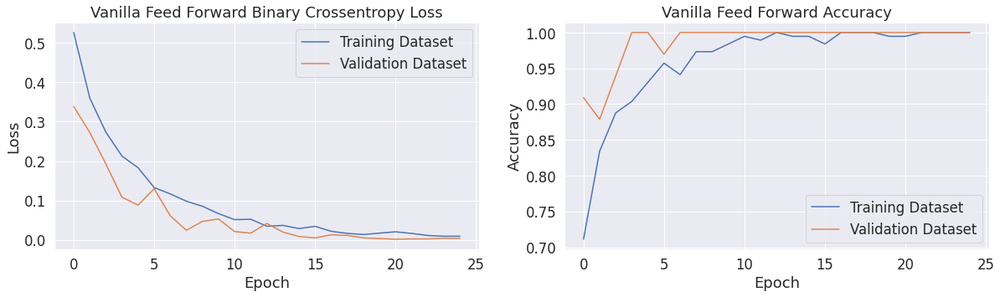

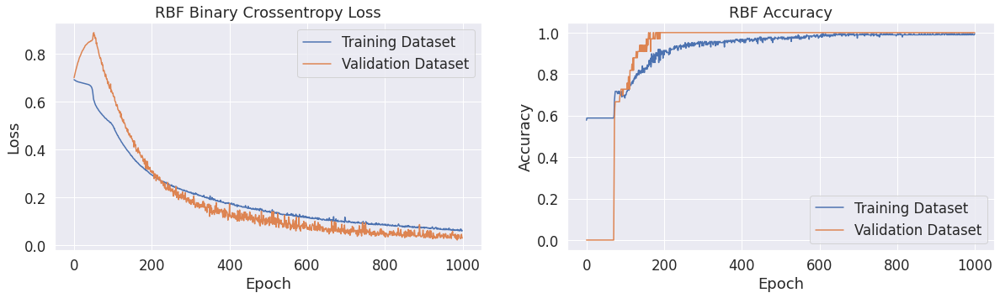

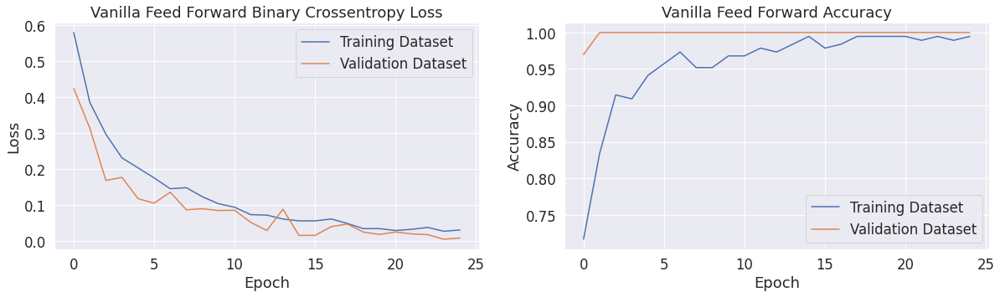

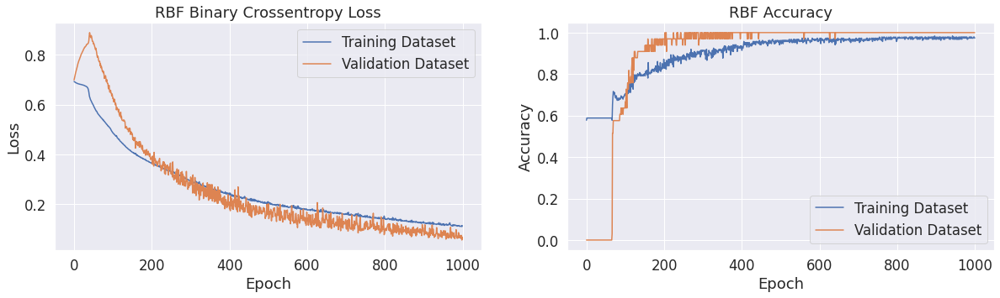

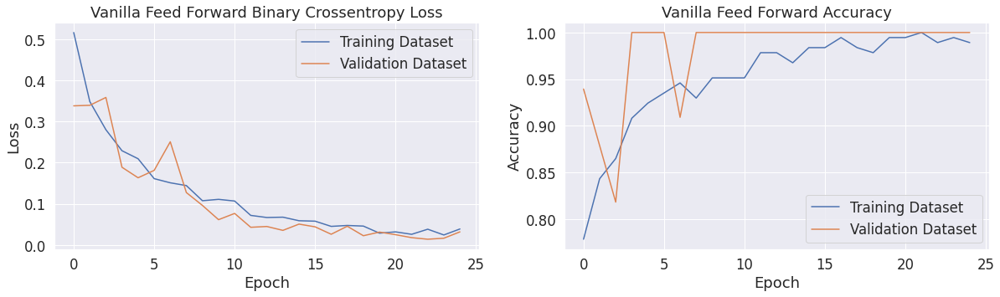

...

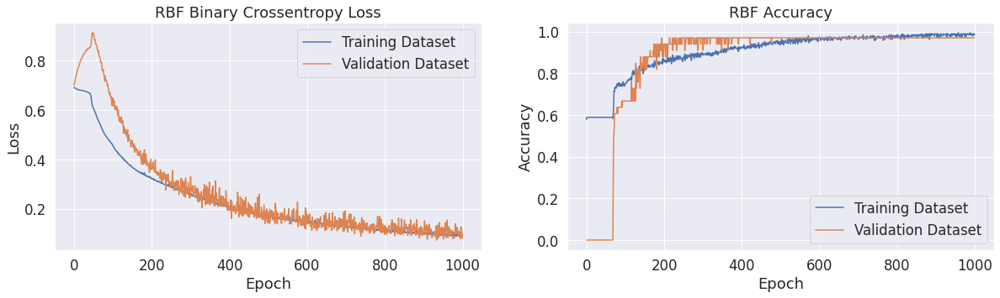

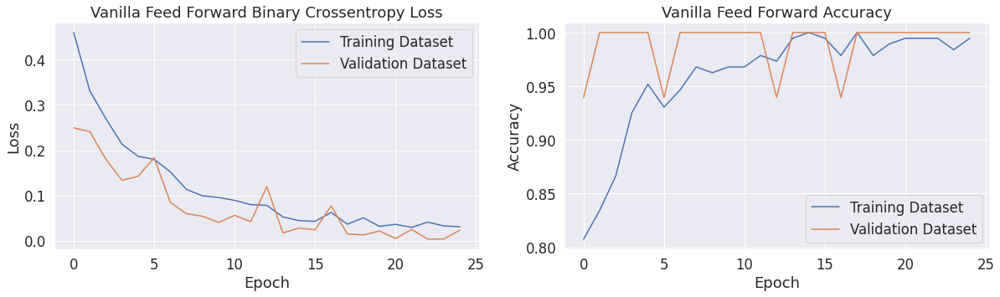

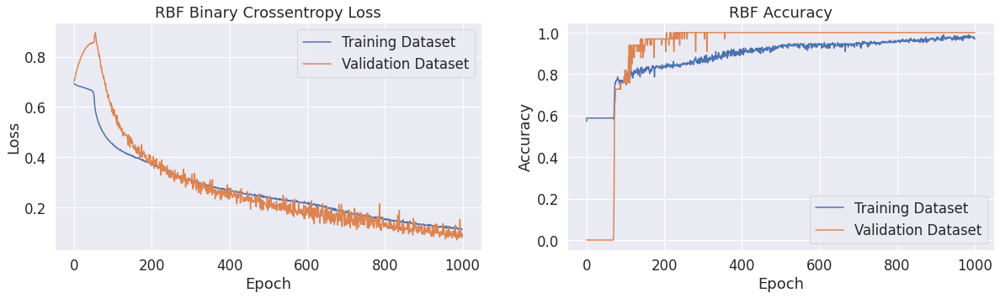

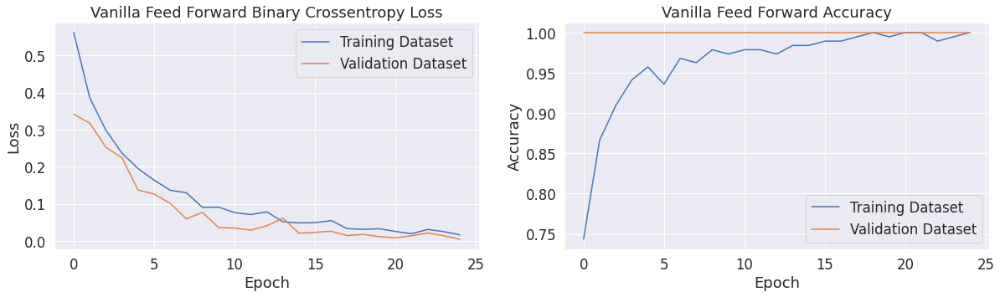

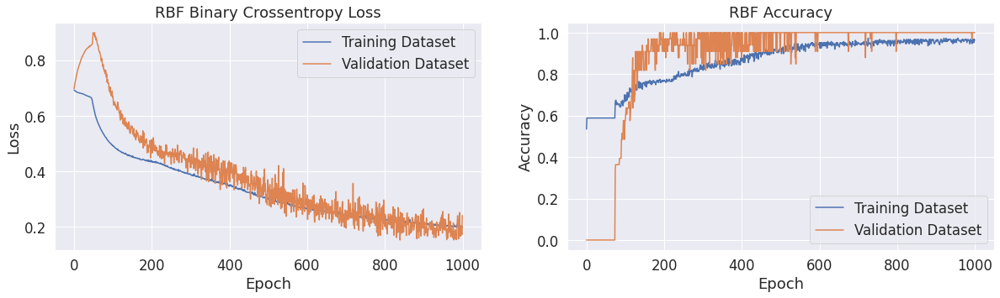

In [ ]:
# Chosen Hyperparameters: 
# VFF 64, 128, 16 (epochs 25)
# DBN 0.00005, 0.0005, 40, 200, 16
# RBF 128, 2, 4 (epochs 1000)

randomized_data_sets = []
results = []

#Create 15 randomized test-train splits
for rand in range(1, 100, 7):
  train_subjects, test_subjects = train_test_split(df_subjects['name'], test_size=0.25, shuffle=True, random_state=rand, stratify=df_subjects['status'])
  train_subjects.reset_index(drop=True, inplace=True)
  test_subjects.reset_index(drop=True, inplace=True)
  training_data_unnormalized = df_data.loc[df['name'].isin(train_subjects)]
  training_class_temp = df_class.loc[df['name'].isin(train_subjects)]
  testing_data_unnormalized = df_data.loc[df['name'].isin(test_subjects)]
  testing_class_temp = df_class.loc[df['name'].isin(test_subjects)]

  x_mean = np.mean(training_data_unnormalized, axis = 0) # Normalize it in the column direction
  x_std = np.std(training_data_unnormalized, axis = 0)
  training_data_temp = (training_data_unnormalized - x_mean) / x_std
  testing_data_temp = (testing_data_unnormalized - x_mean) / x_std

  sm = SMOTE(random_state=RANDOM_STATE)
  training_data_smote_temp, training_class_smote_temp = sm.fit_resample(training_data_temp, training_class_temp)
  randomized_data_sets.append([training_data_smote_temp, training_class_smote_temp, testing_data_temp, testing_class_temp])

# For each train-test split, create, train and test each type of model with the chosen hyperparameters from the previous steps and then save the results
for ds in randomized_data_sets:
  local_model = vff_create_model(64, 128)
  history = pd.DataFrame(local_model.fit(ds[0], ds[1], validation_split = 0.15, batch_size = 16, epochs = 25, verbose = 0).history)
  plot_history_metrics(history, 'Vanilla Feed Forward')
  y_pred = local_model.predict(testing_data)>0.5
  results.append(['VFF', f1_score(testing_class, y_pred, average="weighted"), balanced_accuracy_score(testing_class, y_pred)])

  local_model = dbn_create_model(0.00005, 0.0005, 40, 200, 16)
  local_model.fit(np.array(ds[0]), ds[1])
  y_pred = local_model.predict(testing_data)
  results.append(['DBN', f1_score(testing_class, y_pred, average="weighted"), balanced_accuracy_score(testing_class, y_pred)])

  local_model = rbf_create_model(128, 2.0)
  history = pd.DataFrame(local_model.fit(ds[0], ds[1], validation_split = 0.15, batch_size = 4, epochs = 1000, verbose = 0).history)
  plot_history_metrics(history, 'RBF')
  y_pred = local_model.predict(testing_data)>0.5
  results.append(['RBF', f1_score(testing_class, y_pred, average="weighted"), balanced_accuracy_score(testing_class, y_pred)])

results_df = pd.DataFrame(results, columns = ['Model Name', 'F1 Score', 'Balanced Accuracy'])
history_df = pd.DataFrame(history, columns = ['Model Name', 'hist_df'])

# Please note that the DBN implementation does not provide ability to save and plot training and validation metrics during the training process
# Therefore, only VFF and RBF model training plots and shown below

### Display Results

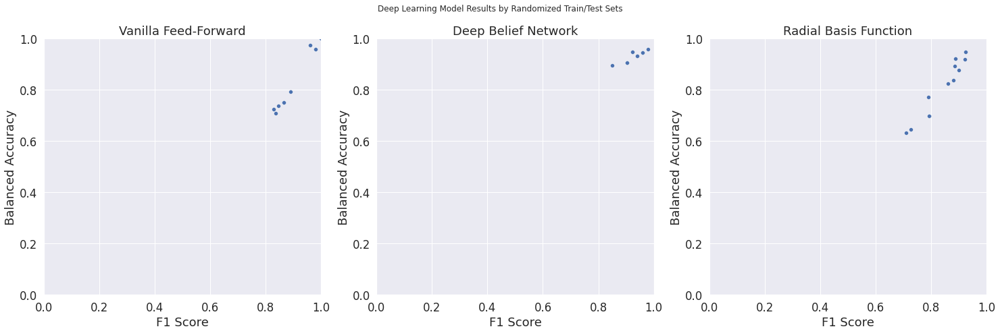

In [ ]:
plt.figure(figsize=(25,7))
models = ['VFF', 'DBN', 'RBF']
titles = ['Vanilla Feed-Forward','Deep Belief Network', 'Radial Basis Function']
for i in range(0,3):
  plt.subplot(1, 3, i+1)
  df_temp = results_df.loc[results_df['Model Name'] == models[i]]
  sns.scatterplot(x = df_temp['F1 Score'], y= df_temp['Balanced Accuracy'])
  plt.ylabel('Balanced Accuracy')
  plt.xlabel('F1 Score')
  plt.xlim(0,1)
  plt.ylim(0,1)
  plt.title(titles[i])
plt.suptitle('Deep Learning Model Results by Randomized Train/Test Sets')
plt.show()

In [ ]:
pd.pivot_table(results_df, index = results_df['Model Name'])

,Balanced Accuracy,F1 Score
Model Name,,
DBN,0.930994,0.926657
RBF,0.814766,0.845351
VFF,0.847661,0.910857


Final performance comparison reveals that Deep Belief Network model performed the best of all models tested with an accuracy of 93% and an F1 score of 0.93